# Equity Analysis of CA Electric Vehicle Public Charging Infrastructure

Authors: Wenqi Luo, Yin Qiu

Yin Qiu contributed to the initial probing of charging station and scale mapping to understand the basic EV charger distribution, which set a stepping stone for equity analysis.

Wenqi Luo contributed to equity analysis by integrating EV charger data, census data, EV registration data and CalEnvrionScreen Score data. The results of equity analysis were presented as visualization (created by tableau) on the Capstone Website https://alison626k.github.io/MIMS21-GEAR/ , in section 2 of equity analysis. 

* References: All data Sources used in the current analysis can be found on our official capstone project website. 

In [ ]:
!pip install geojson
!pip install geopandas
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pylab as pylab
import matplotlib.pyplot as plt
%matplotlib inline
pylab.rcParams['figure.figsize'] = 10, 8

import json
import requests
from geojson import Feature, Point, FeatureCollection
import geopandas as gpd
from geopandas import GeoDataFrame
import fiona
from shapely.geometry import Point
from scipy import ndimage
from pyproj import CRS

import pprint
pp = pprint.PrettyPrinter()

from API_keys import nrel_token, census_token, mapbox_token

# Section 1: Request API and Download Data

### Dataset 1: EV charging stations and Hydrogen fueling stations
Documentation: https://developer.nrel.gov/docs/transportation/alt-fuel-stations-v1/all/

In [ ]:
# NREL API request, California EV charging and Hydrogen fueling stations data
endpoint_url = 'https://developer.nrel.gov/api/alt-fuel-stations/v1.geojson?'+'api_key='+nrel_token+'&fuel_type=ELEC,HY&state=CA'
response = requests.get(endpoint_url)
results = response.text

In [ ]:
data = json.loads(results)
# save a copy of raw station data
with open('data/raw_data_stations.geojson', 'w') as outfile:
    json.dump(data['features'], outfile)

In [ ]:
pp.pprint(data['features'][:1])

[{'geometry': {'coordinates': [-118.3879713743439, 34.2483191527193],
               'type': 'Point'},
  'properties': {'access_code': 'private',
                 'access_days_time': 'Fleet use only',
                 'access_days_time_fr': None,
                 'access_detail_code': None,
                 'bd_blends': None,
                 'bd_blends_fr': None,
                 'cards_accepted': None,
                 'city': 'Sun Valley',
                 'cng_dispenser_num': None,
                 'cng_fill_type_code': None,
                 'cng_psi': None,
                 'cng_renewable_source': None,
                 'cng_total_compression': None,
                 'cng_total_storage': None,
                 'cng_vehicle_class': None,
                 'country': 'US',
                 'date_last_confirmed': '2020-09-03',
                 'e85_blender_pump': None,
                 'e85_other_ethanol_blends': None,
                 'ev_connector_types': ['CHADEMO', 'J1772', 'J177

In [ ]:
# parse station data to geopandas
collection = FeatureCollection(data)
gdf_stations = gpd.GeoDataFrame.from_features(collection['features'])
gdf_stations = gdf_stations[gdf_stations.geometry.isnull()==False] # omit those without geometry

In [ ]:
# view first few lines of raw station data
gdf_stations.head(5)

,geometry,access_code,access_days_time,access_detail_code,cards_accepted,date_last_confirmed,expected_date,fuel_type_code,groups_with_access_code,id,...,ng_fill_type_code,ng_psi,ng_vehicle_class,access_days_time_fr,intersection_directions_fr,bd_blends_fr,groups_with_access_code_fr,ev_pricing_fr,federal_agency,ev_network_ids
0,POINT (-118.38797 34.24832),private,Fleet use only,None,None,2020-09-03,None,ELEC,Private,1517,...,None,None,None,None,None,None,Privé,None,NaN,NaN
1,POINT (-118.08101 34.05074),private,Employee use only,None,None,2021-01-14,None,ELEC,TEMPORARILY UNAVAILABLE (Private),1520,...,None,None,None,None,None,None,TEMPORAIREMENT SUSPENDU (Privé),None,NaN,NaN
2,POINT (-118.27139 34.04054),public,24 hours daily; pay lot,None,None,2020-11-09,None,ELEC,Public,1523,...,None,None,None,None,None,None,Public,None,NaN,NaN
3,POINT (-118.24859 34.05913),private,For fleet and employee use only,None,None,2020-11-09,None,ELEC,Private,1525,...,None,None,None,None,None,None,Privé,None,NaN,NaN
4,POINT (-118.09667 33.75980),private,Fleet use only,None,None,2020-09-03,None,ELEC,Private,1531,...,None,None,None,None,None,None,Privé,None,NaN,NaN


### Dataset 2: California Tracts - Census Cartographic Boundary
Cartographic Boundary Shape files

download source: https://www.census.gov/geographies/mapping-files/time-series/geo/cartographic-boundary.html

<AxesSubplot:>

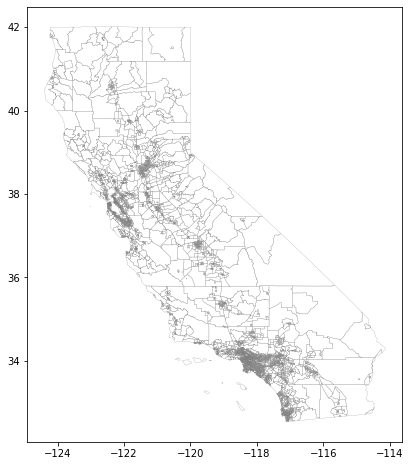

In [ ]:
# parse shape files to geopandas
# blockgroups = gpd.read_file('data/cb_2019_06_bg_500k/cb_2019_06_bg_500k.shp')
# blockgroups.plot(color='none', edgecolor='gray', linewidth=.2, figsize=(12,8))

tracts = gpd.read_file('data/cb_2019_06_tract_500k/cb_2019_06_tract_500k.shp')
tracts.plot(color='none', edgecolor='gray', linewidth=.2, figsize=(12,8))

In [ ]:
# Create the full TractId (TRACTCE only contains partial information) for further merge with charger data
tracts['TractId']= tracts['COUNTYFP'].astype(int).astype(str)+tracts['TRACTCE'].astype(str)


In [ ]:
# cartographic boundary for counties
# yin: counties = tracts.dissolve(by='TRACTCE')
counties = tracts.dissolve(by='TractId')

In [ ]:
tracts.dissolve(by='TRACTCE')

,geometry,STATEFP,COUNTYFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,TractId
TRACTCE,,,,,,,,,,
000100,"MULTIPOLYGON (((-117.19485 32.75446, -117.1918...",06,063,1400000US06063000100,06063000100,1,CT,147292078,698439,63000100
000101,"MULTIPOLYGON (((-119.79698 34.44599, -119.7970...",06,051,1400000US06051000101,06051000101,1.01,CT,4143691194,34523925,51000101
000102,"MULTIPOLYGON (((-119.76869 34.44049, -119.7600...",06,005,1400000US06005000102,06005000102,1.02,CT,456204166,7940832,5000102
000103,"MULTIPOLYGON (((-117.76769 34.02351, -117.7454...",06,039,1400000US06039000103,06039000103,1.03,CT,659835128,3194124,39000103
000104,"MULTIPOLYGON (((-117.76748 34.00461, -117.7670...",06,053,1400000US06053000104,06053000104,1.04,CT,2038307,4276,53000104
...,...,...,...,...,...,...,...,...,...,...
985202,"POLYGON ((-120.54046 37.89595, -120.53254 37.8...",06,109,1400000US06109985202,06109985202,9852.02,CT,726702,0,109985202
988300,"POLYGON ((-121.16686 38.70030, -121.16424 38.7...",06,067,1400000US06067988300,06067988300,9883,CT,3824924,166308,67988300
990000,"MULTIPOLYGON (((-119.05277 33.46586, -119.0463...",06,083,1400000US06083990000,06083990000,9900,CT,0,2405625623,83990000


# Section 2: Data Preprocessing

In [ ]:
# raw data shape of EV charging stations,13718 rows and 62 columns
gdf_stations.query("fuel_type_code == 'ELEC'").shape

(13718, 62)

In [ ]:
# check raw data column names
gdf_stations.columns

Index(['geometry', 'access_code', 'access_days_time', 'access_detail_code',
       'cards_accepted', 'date_last_confirmed', 'expected_date',
       'fuel_type_code', 'groups_with_access_code', 'id', 'open_date',
       'owner_type_code', 'status_code', 'station_name', 'station_phone',
       'updated_at', 'facility_type', 'geocode_status', 'city',
       'intersection_directions', 'plus4', 'state', 'street_address', 'zip',
       'country', 'bd_blends', 'cng_dispenser_num', 'cng_fill_type_code',
       'cng_psi', 'cng_renewable_source', 'cng_total_compression',
       'cng_total_storage', 'cng_vehicle_class', 'e85_blender_pump',
       'e85_other_ethanol_blends', 'ev_connector_types', 'ev_dc_fast_num',
       'ev_level1_evse_num', 'ev_level2_evse_num', 'ev_network',
       'ev_network_web', 'ev_other_evse', 'ev_pricing', 'ev_renewable_source',
       'hy_is_retail', 'hy_pressures', 'hy_standards', 'hy_status_link',
       'lng_renewable_source', 'lng_vehicle_class', 'lpg_primary',
    

In [ ]:
# select and only keep relevant columns
gdf_stations = gdf_stations[['geometry', 'access_code',
             'date_last_confirmed', 'expected_date',
             'fuel_type_code', 'id', 'open_date',
             'owner_type_code', 'status_code', 'station_name',
             'updated_at', 'facility_type', 'geocode_status', 'city',
             'state', 'street_address', 'zip','country',
             'ev_connector_types', 'ev_dc_fast_num','ev_level1_evse_num', 'ev_level2_evse_num',
             'ev_network','ev_network_web', 'ev_other_evse', 'ev_pricing', 'ev_renewable_source','ev_network_ids',
             'hy_is_retail', 'hy_pressures', 'hy_standards', 'hy_status_link', 'federal_agency']]

In [ ]:
# check data shape after filter columns
gdf_stations.shape

(13835, 33)

In [ ]:
# set crs to epsg: 4326
gdf_stations.crs = CRS('epsg:4326')
# blockgroups.crs = CRS('epsg:4326')
tracts.crs = CRS('epsg:4326')
counties.crs = tracts.crs

In [ ]:
# check crs
# print(blockgroups.crs）
print(tracts.crs, counties.crs)
print(gdf_stations.crs)

epsg:4326 epsg:4326
epsg:4326


In [ ]:
# clip stations outside California
gdf_stations = gpd.clip(gdf_stations, tracts)

In [ ]:
# check data shape after filter stations for CA only
gdf_stations.shape

(13829, 33)

MTC has standardized on Universal Transverse Mercator (UTM), Zone 10N, NAD83 for all analysis based projects.

In [ ]:
# projection from 4326 to mtc
mtc_crs = '+proj=utm +zone=10 +ellps=GRS80 +datum=NAD83 +units=m +no_defs'

# blockgroups_proj = blockgroups.to_crs(mtc_crs)
tracts_proj = tracts.to_crs(mtc_crs)
counties_proj = counties.to_crs(mtc_crs)
gdf_stations_proj = gdf_stations.to_crs(mtc_crs)

In [ ]:
# check crs after projection
# print(blockgroups_proj.crs）
print(tracts_proj.crs, counties_proj.crs)
print(gdf_stations_proj.crs)

+proj=utm +zone=10 +ellps=GRS80 +datum=NAD83 +units=m +no_defs +type=crs +proj=utm +zone=10 +ellps=GRS80 +datum=NAD83 +units=m +no_defs +type=crs
+proj=utm +zone=10 +ellps=GRS80 +datum=NAD83 +units=m +no_defs +type=crs


# Section 3: Mapping of EV and HY Stations

### Static Map: overview of all EV and HY charging stations

<Figure size 1296x720 with 0 Axes>

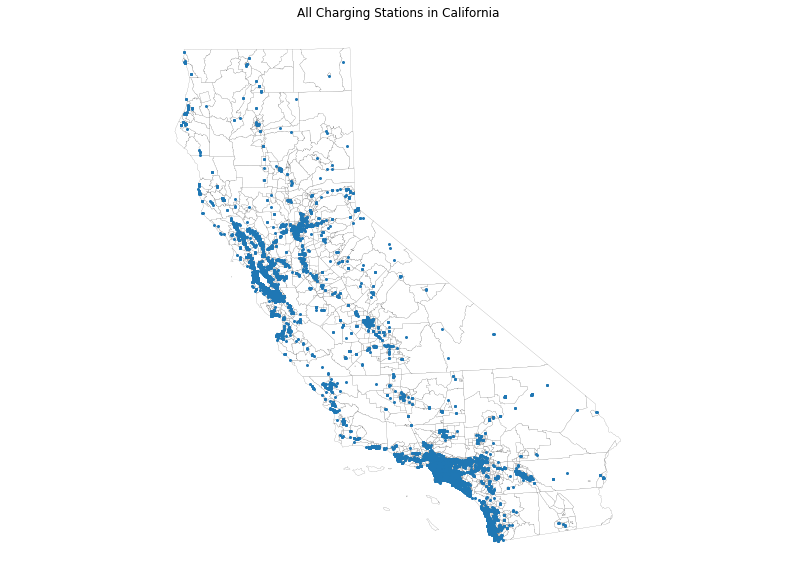

In [ ]:
# mapping with base of tracts
ax = plt.figure(figsize=(18, 10))
ax = tracts_proj.plot(color='white', edgecolor='black', linewidth=.1, figsize=(14,10))
ax.set_title('All Charging Stations in California')
DPI=100
gdf_stations_proj.plot(ax=ax, markersize=4)
ax.set_axis_off()
plt.axis('equal')
plt.savefig('data/All Charging Stations CA.png', dpi=DPI, bbox_inches='tight')


### Interactive Maps: where EV charging and HY charging stations are located, and where the clusters are
Use Mapboxgl library to plot geojson data

documentation: https://github.com/mapbox/mapboxgl-jupyter

In [ ]:
!pip install mapboxgl
from mapboxgl.utils import *
from mapboxgl.viz import *
import os
import warnings; warnings.simplefilter('ignore')

In [ ]:
# extract lon and lat coordinates from the geometry column
gdf_stations['lon'] = gdf_stations['geometry'].x
gdf_stations['lat'] = gdf_stations['geometry'].y

In [ ]:
gdf_stations.head(2)

,geometry,access_code,date_last_confirmed,expected_date,fuel_type_code,id,open_date,owner_type_code,status_code,station_name,...,ev_pricing,ev_renewable_source,ev_network_ids,hy_is_retail,hy_pressures,hy_standards,hy_status_link,federal_agency,lon,lat
0,POINT (-118.38797 34.24832),private,2020-09-03,None,ELEC,1517,1999-10-15,LG,E,LADWP - Truesdale Center,...,None,None,NaN,None,None,None,None,NaN,-118.387971,34.248319
1,POINT (-118.08101 34.05074),private,2021-01-14,None,ELEC,1520,None,T,T,Southern California Edison - Rosemead Office B...,...,None,None,NaN,None,None,None,None,NaN,-118.081014,34.050745


In [ ]:
# create a pandas df
df_stations = pd.DataFrame(gdf_stations)
df_stations.drop('geometry', axis=1, inplace=True)
df_stations.head(2)

,access_code,date_last_confirmed,expected_date,fuel_type_code,id,open_date,owner_type_code,status_code,station_name,updated_at,...,ev_pricing,ev_renewable_source,ev_network_ids,hy_is_retail,hy_pressures,hy_standards,hy_status_link,federal_agency,lon,lat
0,private,2020-09-03,None,ELEC,1517,1999-10-15,LG,E,LADWP - Truesdale Center,2021-03-29T02:41:38Z,...,None,None,NaN,None,None,None,None,NaN,-118.387971,34.248319
1,private,2021-01-14,None,ELEC,1520,None,T,T,Southern California Edison - Rosemead Office B...,2021-03-11T23:22:17Z,...,None,None,NaN,None,None,None,None,NaN,-118.081014,34.050745


In [ ]:
# save to csv file
df_stations.to_csv('data/all_stations.csv')
df_ev = df_stations[df_stations['fuel_type_code']=='ELEC']
df_ev.to_csv('data/ev_stations.csv')
df_hy = df_stations[df_stations['fuel_type_code']=='HY']
df_hy.to_csv('data/hy_stations.csv')

In [ ]:
# save to geojson file
df_to_geojson(
      df_stations,
      filename="data/all_stations.geojson",
      properties=['access_code',
             'date_last_confirmed', 'expected_date',
             'fuel_type_code', 'id', 'open_date',
             'owner_type_code', 'station_name',
             'facility_type', 'geocode_status', 'city',
             'state', 'street_address', 'zip','country',
             'ev_connector_types', 'ev_dc_fast_num','ev_level1_evse_num', 'ev_level2_evse_num',
             'ev_network','ev_network_web', 'ev_other_evse', 'ev_pricing', 'ev_network_ids',
             'hy_is_retail', 'hy_pressures', 'hy_standards', 'hy_status_link', 'federal_agency'],
      lat = 'lat',
      lon = 'lon',
      precision=4)

{'type': 'file',
 'filename': 'data/all_stations.geojson',
 'feature_count': 13829}

In [ ]:
df_to_geojson(
      df_ev,
      filename="data/ev_stations.geojson",
      properties=['access_code',
             'date_last_confirmed', 'expected_date',
             'fuel_type_code', 'id', 'open_date',
             'owner_type_code', 'station_name',
             'facility_type', 'geocode_status', 'city',
             'state', 'street_address', 'zip','country',
             'ev_connector_types', 'ev_dc_fast_num','ev_level1_evse_num', 'ev_level2_evse_num',
             'ev_network','ev_network_web', 'ev_other_evse', 'ev_pricing', 'ev_network_ids'],
      lat = 'lat',
      lon = 'lon',
      precision=4)

{'type': 'file',
 'filename': 'data/ev_stations.geojson',
 'feature_count': 13712}

In [ ]:
df_to_geojson(
      df_hy,
      filename="data/hy_stations.geojson",
      properties=['access_code',
             'date_last_confirmed', 'expected_date',
             'fuel_type_code', 'id', 'open_date',
             'owner_type_code', 'station_name',
             'facility_type', 'geocode_status', 'city',
             'state', 'street_address', 'zip','country',
             'hy_is_retail', 'hy_pressures', 'hy_standards', 'hy_status_link', 'federal_agency'],
      lat = 'lat',
      lon = 'lon',
      precision=4)

{'type': 'file', 'filename': 'data/hy_stations.geojson', 'feature_count': 117}

In [ ]:
# create geojson data for all stations
geodata = df_to_geojson(
      df_stations,
      properties = ['fuel_type_code', 'facility_type',
                    'ev_network','ev_dc_fast_num','ev_level1_evse_num', 'ev_level2_evse_num',
                     'hy_pressures', 'hy_standards'],
      lat = 'lat',
      lon = 'lon',
      precision=4)

In [ ]:
# check the first line of geojson
pp.pprint(geodata['features'][:1])

[{'geometry': {"coordinates": [-118.388, 34.2483], "type": "Point"},
  'properties': {'ev_dc_fast_num': 2.0,
                 'ev_level1_evse_num': None,
                 'ev_level2_evse_num': 40.0,
                 'ev_network': 'Non-Networked',
                 'facility_type': 'UTILITY',
                 'fuel_type_code': 'ELEC',
                 'hy_pressures': None,
                 'hy_standards': None},
  'type': 'Feature'}]


In [ ]:
# create geojson data for ev stations and hy stations
ev_data = df_to_geojson(
      df_ev,
      properties = ['fuel_type_code', 'facility_type',
                    'ev_dc_fast_num','ev_level1_evse_num', 'ev_level2_evse_num','ev_network', 'ev_other_evse'],
      lat = 'lat',
      lon = 'lon',
      precision=4)


hy_data = df_to_geojson(
      df_hy,
      properties = ['fuel_type_code', 'facility_type',
                    'hy_is_retail', 'hy_pressures', 'hy_standards'],
      lat = 'lat',
      lon = 'lon',
      precision=4)

In [ ]:
# Create a Circle map with two categories: EV and Hydrogen
match_color_stops = [['ELEC', 'rgb(34, 139, 34)'], # forest green for EV
                     ['HY', 'rgb(0, 255, 255)']] # aqua for Hydrogen (HY)

viz1 = CircleViz(geodata, 
                    access_token=mapbox_token,
                    color_property='fuel_type_code', 
                    color_stops=match_color_stops, 
                    color_function_type='match', 
                    color_default='rgba(52,73,94,0.5)', 
                    radius=2.5,
                    opacity=0.5, 
                    center=(-118, 37), 
                    zoom=4.5, 
                    below_layer='waterway-label')
viz1.show()

# save to html
with open('data/Allstat_circleviz.html', 'w') as f:
    f.write(viz1.create_html())

From the map above, we can see most of the stations are located in metropolitan areas or along highways. The numbers of EV charging stations are way more than Hydrogen fueling stations. Hydrogen fueling statoins are mostly in Bay Area and in and around Los Angeles. It will be helpful if we can see the clustered map for a better idea.

In [ ]:
# EV stations clustered circle map
color_stops = create_color_stops([1, 10, 25, 50, 75, 100, 1000], colors='Greens')

viz3 = ClusteredCircleViz(ev_data, 
                          access_token=mapbox_token,
                          color_stops=color_stops,
                          stroke_color='black',
                          radius_stops=[[1, 5], [10, 10], [50, 15], [100, 20]],
                          radius_default=2,
                          cluster_maxzoom=10,
                          cluster_radius=30,
                          label_size=12,
                          opacity=0.9,
                          center=(-118, 37),
                          zoom=4.5)
viz3.show()

# save to html
# with open('data/EVstat_clusters.html', 'w') as f:
#     f.write(viz3.create_html())

We can find two major clusters of EV stations, one cluster in Bay Area (Alameda, Contra Costa, Marin, Napa, San Francisco, San Mateo, Santa Clara, Solano, and Sonoma), another cluster around LA metropolitan area (Los Angeles County, Orange County, San Bernardino County, Riverside County and Ventura County). We also find relatively big clusters around San Diego County, Sacramento County and Fresno County.

# Section 4: Exploratory Data Analysis (EDA)

Explore characteristics and distribution of EV and HY stations

In [ ]:
# check column names
print(df_ev.columns)
print(df_hy.columns)

Index(['access_code', 'date_last_confirmed', 'expected_date', 'fuel_type_code',
       'id', 'open_date', 'owner_type_code', 'status_code', 'station_name',
       'updated_at', 'facility_type', 'geocode_status', 'city', 'state',
       'street_address', 'zip', 'country', 'ev_connector_types',
       'ev_dc_fast_num', 'ev_level1_evse_num', 'ev_level2_evse_num',
       'ev_network', 'ev_network_web', 'ev_other_evse', 'ev_pricing',
       'ev_renewable_source', 'ev_network_ids', 'hy_is_retail', 'hy_pressures',
       'hy_standards', 'hy_status_link', 'federal_agency', 'lon', 'lat'],
      dtype='object')
Index(['access_code', 'date_last_confirmed', 'expected_date', 'fuel_type_code',
       'id', 'open_date', 'owner_type_code', 'status_code', 'station_name',
       'updated_at', 'facility_type', 'geocode_status', 'city', 'state',
       'street_address', 'zip', 'country', 'ev_connector_types',
       'ev_dc_fast_num', 'ev_level1_evse_num', 'ev_level2_evse_num',
       'ev_network', 'ev_net

### EV Stations - Characteristics

16.94764397905759

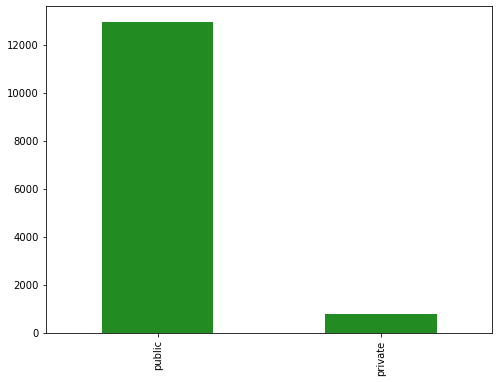

In [ ]:
# EV stations: public vs private
plt.figure(figsize=[8,6])
ax = df_ev['access_code'].value_counts().plot(kind='bar', color='forestgreen')

# ratio of public / private stations is about 10.6
evratio = df_ev['access_code'].value_counts()[0]/df_ev['access_code'].value_counts()[1]
evratio

<AxesSubplot:>

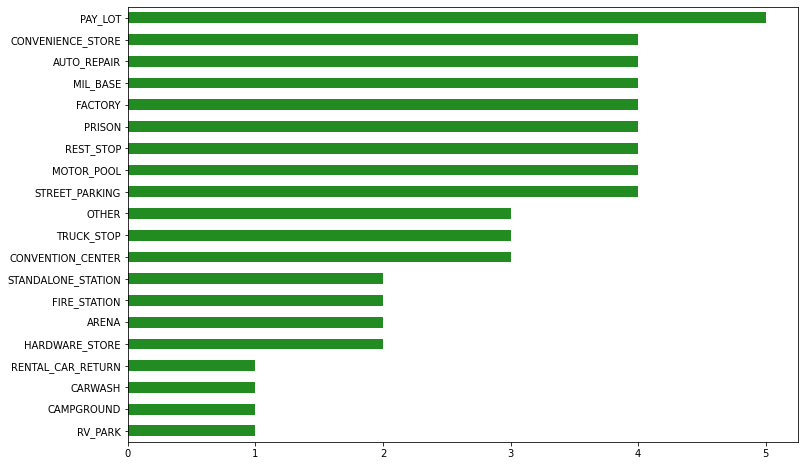

In [ ]:
# EV stations: top 20 facility types
plt.figure(figsize=[12,8])
df_ev['facility_type'].value_counts().sort_values()[:20].plot(kind='barh', color='forestgreen')

ChargePoint Network    8911
Non-Networked          1447
Tesla Destination       832
Greenlots               358
EV Connect              346
eVgo Network            325
SemaCharge Network      285
Blink Network           284
Volta                   216
Tesla                   211
Electrify America       195
FLO                     184
POWERFLEX                65
OpConnect                26
EVGATEWAY                19
EVCS                      7
AMPUP                     1
Name: ev_network, dtype: int64


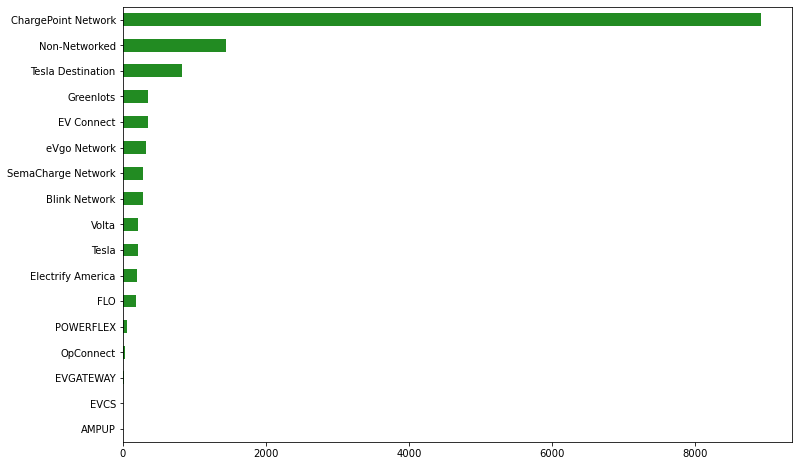

In [ ]:
# EV stations: EV charging networks
plt.figure(figsize=[12,8])
df_ev['ev_network'].value_counts().sort_values().plot(kind='barh', color='forestgreen')
print(df_ev['ev_network'].value_counts().sort_values(ascending=False))

ev_dc_fast_num         5648.0
ev_level2_evse_num    32084.0
ev_level1_evse_num      720.0
dtype: float64
DC fast percentage: 15.7 %
Level 2 EVSE percentage: 82.88 %
Level 1 EVSE percentage: 1.42 %


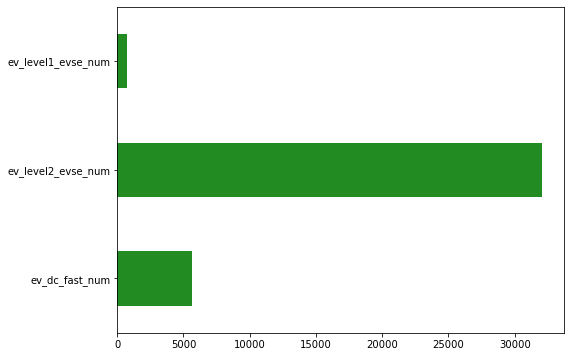

In [ ]:
# EV stations: level 1, level 2 and DC Fast chargers
plt.figure(figsize=[8,6])
df_ev[['ev_dc_fast_num', 'ev_level2_evse_num', 'ev_level1_evse_num']].sum(axis=0).plot(kind='barh', color='forestgreen')
print(df_ev[['ev_dc_fast_num', 'ev_level2_evse_num', 'ev_level1_evse_num']].sum(axis=0))
print('DC fast percentage:', round(100*5405/(5405+28529+490),2), '%')
print('Level 2 EVSE percentage:', round(100*28529/(5405+28529+490),2), '%')
print('Level 1 EVSE percentage:', round(100*490/(5405+28529+490),2), '%')

In [ ]:
# Geoprocessing: Using Intersect to Assign Polygon ID and Attributes to Points
# spatial join points of stations with tracts
gdf_stations_proj_tracts = gpd.sjoin(gdf_stations_proj, tracts_proj, how="inner", op='intersects')
gdf_stations_proj_tracts.head(2)

,geometry,access_code,date_last_confirmed,expected_date,fuel_type_code,id,open_date,owner_type_code,status_code,station_name,...,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,TractId
0,POINT (924836.838 3799324.883),private,2020-09-03,None,ELEC,1517,1999-10-15,LG,E,LADWP - Truesdale Center,...,06,037,121102,1400000US06037121102,06037121102,1211.02,CT,7463001,76989,37121102
112,POINT (924668.465 3798606.266),private,2020-09-03,None,ELEC,33183,1999-10-15,LG,E,LADWP - Valley Generating Station,...,06,037,121102,1400000US06037121102,06037121102,1211.02,CT,7463001,76989,37121102


### Stations by 8057 Tracts - Distribution

In [ ]:
gdf_stations_proj_tracts['fuel_type_code'].unique()

array(['ELEC', 'HY'], dtype=object)

### Constrain to public EV charging stations

In [ ]:
pub_ev_proj_tracts = gdf_stations_proj_tracts[(gdf_stations_proj_tracts['access_code']=='public') & (gdf_stations_proj_tracts['fuel_type_code']=='ELEC')]
pub_ev_tract_stations=pub_ev_proj_tracts.groupby('TractId')['id'].count().to_frame(name='total_stations')

In [ ]:
pub_proj_tracts = gdf_stations_proj_tracts[(gdf_stations_proj_tracts['access_code']=='public')]
pub_tract_stations=pub_proj_tracts.groupby('TractId')['id'].count().to_frame(name='total_stations')


In [ ]:
gdf_stations_proj_tracts.columns

Index(['geometry', 'access_code', 'date_last_confirmed', 'expected_date',
       'fuel_type_code', 'id', 'open_date', 'owner_type_code', 'status_code',
       'station_name', 'updated_at', 'facility_type', 'geocode_status', 'city',
       'state', 'street_address', 'zip', 'country', 'ev_connector_types',
       'ev_dc_fast_num', 'ev_level1_evse_num', 'ev_level2_evse_num',
       'ev_network', 'ev_network_web', 'ev_other_evse', 'ev_pricing',
       'ev_renewable_source', 'ev_network_ids', 'hy_is_retail', 'hy_pressures',
       'hy_standards', 'hy_status_link', 'federal_agency', 'index_right',
       'STATEFP', 'COUNTYFP', 'TRACTCE', 'AFFGEOID', 'GEOID', 'NAME', 'LSAD',
       'ALAND', 'AWATER', 'TractId'],
      dtype='object')

In [ ]:
## get number of Level1, Level2 and DC Fast charger for each census tract
pub_ev_proj_tracts = gdf_stations_proj_tracts[(gdf_stations_proj_tracts['access_code']=='public') & (gdf_stations_proj_tracts['fuel_type_code']=='ELEC')]
pub_ev_tract_L1_charger=pub_ev_proj_tracts.groupby('TractId')['ev_level1_evse_num'].sum()
pub_ev_tract_L2_charger=pub_ev_proj_tracts.groupby('TractId')['ev_level2_evse_num'].sum()
pub_ev_tract_fast_charger=pub_ev_proj_tracts.groupby('TractId')['ev_dc_fast_num'].sum()
pub_ev_tract_L1_charger


TractId
101050102    0.0
101050201    0.0
101050603    0.0
103000100    0.0
103000600    0.0
            ... 
99003603     0.0
99003605     0.0
99003700     0.0
99003805     0.0
99003908     0.0
Name: ev_level1_evse_num, Length: 2723, dtype: float64

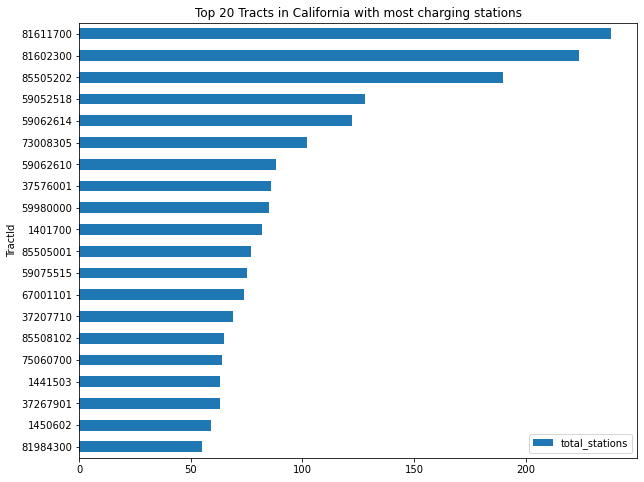

In [ ]:
# get the total number of charging station by census tract
tract_stations = pub_ev_proj_tracts.groupby('TractId')['id'].count().to_frame(name='total_stations')
ax = tract_stations.sort_values('total_stations')[-20:].plot(kind='barh', title='Top 20 Tracts in California with most charging stations')


In [ ]:
# get 2017 US census dataset from American Community Survey
census_df = pd.read_csv("2017census.csv")
census_df

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,multi_house_pct,single_house_pct
0,0,1400100,California,Alameda County,2991,1442,1549,3.8,69.2,2.8,...,20.0,34.8,1543,80.6,6.6,12.8,0.0,4.0,2.8,97.2
1,1,1400200,California,Alameda County,1997,992,1005,8.9,71.3,0.9,...,11.8,29.2,1231,77.4,10.2,11.6,0.8,3.7,29.6,70.5
2,2,1400300,California,Alameda County,5123,2383,2740,7.5,67.0,9.4,...,10.3,31.3,3213,73.0,17.8,9.2,0.0,5.5,54.1,45.7
3,3,1400400,California,Alameda County,3991,1810,2181,9.4,65.8,6.0,...,9.1,30.4,2499,73.9,15.2,10.7,0.3,5.0,55.4,44.7
4,4,1400500,California,Alameda County,3944,1660,2284,10.3,53.4,24.1,...,14.0,32.4,2587,77.1,14.1,8.8,0.0,2.6,46.9,53.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8052,8052,115040800,California,Yuba County,4508,2380,2128,17.5,72.4,0.1,...,2.5,33.4,1927,68.4,28.4,3.2,0.0,10.5,10.6,84.6
8053,8053,115040901,California,Yuba County,3080,1562,1518,19.0,67.1,0.2,...,9.6,36.3,1269,68.6,17.2,12.2,2.0,12.4,3.5,73.8
8054,8054,115040902,California,Yuba County,1530,908,622,18.4,54.6,8.9,...,1.5,10.5,198,37.9,58.6,3.5,0.0,15.0,11.8,88.2
8055,8055,115041000,California,Yuba County,7365,3971,3394,10.4,78.1,4.6,...,10.9,41.2,2958,54.8,27.5,17.7,0.0,5.2,0.3,91.0


In [ ]:
census_df['TRACTCE']=census_df['TractId'].apply(lambda x: str(x)[-6:])


### get each tract's number of all public ev stations, number of different types of chargers

In [ ]:
#tract_stations=tract_stations.reset_index()
tract_stations['total_L1_charger']=list(pub_ev_tract_L1_charger)
tract_stations['total_L2_charger']=list(pub_ev_tract_L2_charger)
tract_stations['total_fast_charger']=list(pub_ev_tract_fast_charger)
tract_stations

,total_stations,total_L1_charger,total_L2_charger,total_fast_charger
TractId,,,,
101050102,2,0.0,5.0,2.0
101050201,1,0.0,5.0,0.0
101050603,1,0.0,0.0,10.0
103000100,1,0.0,2.0,0.0
103000600,6,0.0,5.0,11.0
...,...,...,...,...
99003603,1,0.0,1.0,0.0
99003605,5,0.0,11.0,0.0
99003700,1,0.0,2.0,0.0


In [ ]:
pub_tract_stations=pub_tract_stations.reset_index()
pub_tract_stations

,TractId,total_stations
0,101050102,2
1,101050201,1
2,101050603,1
3,103000100,1
4,103000600,6
...,...,...
2754,99003603,1
2755,99003605,5
2756,99003700,1
2757,99003805,2


In [ ]:
pub_ev_tract_stations=pub_ev_tract_stations.reset_index()
pub_ev_tract_stations

,TractId,total_stations
0,101050102,2
1,101050201,1
2,101050603,1
3,103000100,1
4,103000600,6
...,...,...
2718,99003603,1
2719,99003605,5
2720,99003700,1
2721,99003805,2


### get the percentage of census with at least 1 charging station


In [ ]:
print(round(2755/8057, 2)*100,"% tracts have some HY/EV charging station(s).")

34.0 % tracts have some HY/EV charging station(s).


In [ ]:
# merge census df with tract station df
census_df['TractId']==str(census_df['TractId'])
tract_stations= tract_stations.reset_index()
tract_stations['TractId']=tract_stations['TractId'].astype(int)
# make census_df to be the new merged dataset
census_df = census_df.merge(tract_stations, how = "left")

In [ ]:
census_df.columns

Index(['Unnamed: 0', 'TractId', 'State', 'County', 'TotalPop', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'VotingAgeCitizen', 'Income', 'IncomeErr', 'IncomePerCap',
       'IncomePerCapErr', 'Poverty', 'ChildPoverty', 'Professional', 'Service',
       'Office', 'Construction', 'Production', 'Drive', 'Carpool', 'Transit',
       'Walk', 'OtherTransp', 'WorkAtHome', 'MeanCommute', 'Employed',
       'PrivateWork', 'PublicWork', 'SelfEmployed', 'FamilyWork',
       'Unemployment', 'multi_house_pct', 'single_house_pct', 'TRACTCE',
       'total_stations', 'total_L1_charger', 'total_L2_charger',
       'total_fast_charger'],
      dtype='object')

In [ ]:
#fill na(no charger/charging station) with 0
census_df = census_df.fillna(0)


## Equity analysis 1 : multi-unit & single-unit dwelling 

In [ ]:
# a = census_df[(census_df['multi_house_pct']>0)& (census_df['total_stations']<200)&(census_df['total_stations']>0)]
# a['station per pop']=a['TotalPop']/a['total_stations']/1000
# a

In [ ]:
census_df_multihouse = census_df[census_df['multi_house_pct']>0]
census_df_multihouse['TractId']= census_df_multihouse['TractId'].astype(str)
census_df_multihouse = pd.merge(census_df_multihouse,tracts,how="right",on="TractId")
# save results to csv for tableau visualization
census_df_multihouse.to_csv('data/census_df_tracts.csv')
census_df_multihouse 

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,STATEFP,COUNTYFP,TRACTCE_y,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
0,616.0,13370000,California,Contra Costa County,2794.0,1266.0,1528.0,16.7,47.0,12.1,...,06,013,370000,1400000US06013370000,06013370000,3700,CT,999356,0,"POLYGON ((-122.32697 37.93502, -122.32610 37.9..."
1,288.0,1442301,California,Alameda County,4948.0,2593.0,2355.0,17.9,21.3,3.6,...,06,001,442301,1400000US06001442301,06001442301,4423.01,CT,1429049,0,"POLYGON ((-121.97010 37.53047, -121.96894 37.5..."
2,2349.0,37405101,California,Los Angeles County,5631.0,3056.0,2575.0,74.4,7.3,0.5,...,06,037,405101,1400000US06037405101,06037405101,4051.01,CT,1121229,0,"POLYGON ((-117.96926 34.09945, -117.96489 34.0..."
3,1663.0,37199800,California,Los Angeles County,5404.0,2638.0,2766.0,60.2,0.7,0.0,...,06,037,199800,1400000US06037199800,06037199800,1998,CT,651258,0,"POLYGON ((-118.21562 34.07364, -118.21036 34.0..."
4,2113.0,37291300,California,Los Angeles County,2697.0,1400.0,1297.0,24.1,18.9,7.2,...,06,037,291300,1400000US06037291300,06037291300,2913,CT,2353751,45836,"POLYGON ((-118.30915 33.86198, -118.30915 33.8..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8036,7780.0,107002202,California,Tulare County,6330.0,2995.0,3335.0,76.2,11.6,8.1,...,06,107,002202,1400000US06107002202,06107002202,22.02,CT,2725915,0,"POLYGON ((-119.38437 36.21072, -119.37425 36.2..."
8037,560.0,13351101,California,Contra Costa County,2655.0,933.0,1722.0,1.7,89.1,0.6,...,06,013,351101,1400000US06013351101,06013351101,3511.01,CT,2429606,0,"POLYGON ((-122.07980 37.86534, -122.07866 37.8..."
8038,84.0,1408000,California,Alameda County,2762.0,1293.0,1469.0,10.6,50.4,14.4,...,06,001,408000,1400000US06001408000,06001408000,4080,CT,1955675,0,"POLYGON ((-122.19720 37.81096, -122.19465 37.8..."
8039,3952.0,59032043,California,Orange County,3711.0,1858.0,1853.0,10.9,77.3,1.4,...,06,059,032043,1400000US06059032043,06059032043,320.43,CT,11270566,0,"POLYGON ((-117.57801 33.64257, -117.57795 33.6..."


In [ ]:
# get multi_house percentage by county
census_df_multihouse['multi_house_pop'] = census_df_multihouse['TotalPop']*census_df_multihouse['multi_house_pct']/100
census_totalpop = list(census_df_multihouse.groupby(['County'])['TotalPop'].sum())
multi_house_pop = list(census_df_multihouse.groupby(['County'])['multi_house_pop'].sum())
county_multihouse_pct= [j/i*100 for i, j in zip(census_totalpop,multi_house_pop)]

In [ ]:
cnty_totalpop= list(census_df.groupby(['County'])['TotalPop'].sum())
cnty_totalstation = list(census_df.groupby(['County'])['total_stations'].sum())
xpop_per_charger = [i/j for i, j in zip(cnty_totalpop,cnty_totalstation)]
#a= list(census_df.groupby(['County'])['TotalPop'].sum())
#cnty_totalstation = list(census_df.groupby(['County'])['total_stations'].sum())
all_counties = list(census_df.groupby(['County'])['TotalPop'].sum().reset_index()['County'])
#get number of chargers per million population at county level 
chargers_per_million_pop =[j/(i/1000000) for i, j in zip(cnty_totalpop,cnty_totalstation)]
#multi_unit_county ={'County': census_df_multihouse['County'].unique(), 'Multi-Unit Percentage':  county_multihouse_pct, 'Population Per Station':xpop_per_charger}
# get rid of "county" appendix from county name 
all_counties = [i[:-7] for i in all_counties]

multi_unit_county2 ={'County': all_counties, 'Multi-Unit Percentage':  county_multihouse_pct, 'Chargers per Million Population':list(chargers_per_million_pop)}
#save to csv for tableau visualization 
pd.DataFrame(multi_unit_county2).to_csv('data/multi_unit_pop_charger2.csv')

pd.DataFrame(multi_unit_county2)

,County,Multi-Unit Percentage,Chargers per Million Population
0,Alameda,35.286264,459.617762
1,Alpine,31.000000,3325.020781
2,Amador,7.544683,321.664075
3,Butte,21.867440,88.807186
4,Calaveras,5.063764,88.776439
5,Colusa,12.395726,186.228409
6,Contra Costa,23.108011,260.750856
7,Del Norte,10.709464,400.845419
8,El Dorado,13.854783,329.702997
9,Fresno,26.738355,288.179692


In [ ]:
# df_to_geojson(
#       census_df_multihouse,
#       filename="census_df_multihouse.geojson",
#       properties=['TractId', 'State', 'County', 'TotalPop', 'Men', 'Women',
#        'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
#        'VotingAgeCitizen', 'Income', 'IncomeErr', 'IncomePerCap',
#        'IncomePerCapErr', 'Poverty', 'ChildPoverty', 'Professional', 'Service',
#        'Office', 'Construction', 'Production', 'Drive', 'Carpool', 'Transit',
#        'Walk', 'OtherTransp', 'WorkAtHome', 'MeanCommute', 'Employed',
#        'PrivateWork', 'PublicWork', 'SelfEmployed', 'FamilyWork',
#        'Unemployment', 'multi_house_pct', 'single_house_pct', 'TRACTCE_x',
#        'total_stations', 'STATEFP', 'COUNTYFP', 'TRACTCE_y', 'AFFGEOID',
#        'GEOID', 'NAME', 'LSAD', 'ALAND', 'AWATER', 'geometry'],
#       lat = 'lat',
#       lon = 'lon',
#       precision=4)
import fiona
gpd.GeoDataFrame(census_df_multihouse).to_file('census_df_multihouse.geojson',driver="GeoJSON")
# files.download("census_df_multihouse.geojson")

### mapbox 3D (multi-unit housing VS number of charging stations)

In [ ]:
!pip install geopandas
import geopandas
df = geopandas.read_file("census_df_multihouse.geojson")

In [ ]:
df.columns

Index(['Unnamed: 0', 'TractId', 'State', 'County', 'TotalPop', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'VotingAgeCitizen', 'Income', 'IncomeErr', 'IncomePerCap',
       'IncomePerCapErr', 'Poverty', 'ChildPoverty', 'Professional', 'Service',
       'Office', 'Construction', 'Production', 'Drive', 'Carpool', 'Transit',
       'Walk', 'OtherTransp', 'WorkAtHome', 'MeanCommute', 'Employed',
       'PrivateWork', 'PublicWork', 'SelfEmployed', 'FamilyWork',
       'Unemployment', 'multi_house_pct', 'single_house_pct', 'TRACTCE_x',
       'total_stations', 'STATEFP', 'COUNTYFP', 'TRACTCE_y', 'AFFGEOID',
       'GEOID', 'NAME', 'LSAD', 'ALAND', 'AWATER', 'geometry'],
      dtype='object')

In [ ]:
df = df[['TractId','County','TotalPop','']]

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,STATEFP,COUNTYFP,TRACTCE_y,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
0,0,1400100,California,Alameda County,2991,1442,1549,3.8,69.2,2.8,...,06,001,400100,1400000US06001400100,06001400100,4001,CT,6894339,0,"POLYGON ((-122.24692 37.88544, -122.24197 37.8..."
1,1,1400200,California,Alameda County,1997,992,1005,8.9,71.3,0.9,...,06,001,400200,1400000US06001400200,06001400200,4002,CT,586559,0,"POLYGON ((-122.25742 37.84310, -122.25620 37.8..."
2,2,1400300,California,Alameda County,5123,2383,2740,7.5,67.0,9.4,...,06,001,400300,1400000US06001400300,06001400300,4003,CT,1105851,0,"POLYGON ((-122.26416 37.84000, -122.26186 37.8..."
3,3,1400400,California,Alameda County,3991,1810,2181,9.4,65.8,6.0,...,06,001,400400,1400000US06001400400,06001400400,4004,CT,715630,0,"POLYGON ((-122.26180 37.84179, -122.26130 37.8..."
4,4,1400500,California,Alameda County,3944,1660,2284,10.3,53.4,24.1,...,06,001,400500,1400000US06001400500,06001400500,4005,CT,590297,0,"POLYGON ((-122.26941 37.84811, -122.26841 37.8..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7469,8052,115040800,California,Yuba County,4508,2380,2128,17.5,72.4,0.1,...,06,115,040800,1400000US06115040800,06115040800,408,CT,109401417,128316,"POLYGON ((-121.51583 39.03013, -121.51504 39.0..."
7470,8053,115040901,California,Yuba County,3080,1562,1518,19.0,67.1,0.2,...,06,115,040901,1400000US06115040901,06115040901,409.01,CT,263652570,4473094,"POLYGON ((-121.58249 39.13654, -121.58036 39.1..."
7471,8054,115040902,California,Yuba County,1530,908,622,18.4,54.6,8.9,...,06,115,040902,1400000US06115040902,06115040902,409.02,CT,93617079,240059,"POLYGON ((-121.47709 39.14366, -121.46775 39.1..."
7472,8055,115041000,California,Yuba County,7365,3971,3394,10.4,78.1,4.6,...,06,115,041000,1400000US06115041000,06115041000,410,CT,468397390,6927408,"POLYGON ((-121.63631 39.24941, -121.63581 39.2..."


In [ ]:
mapbox_token='pk.eyJ1Ijoid2VucWlsdW8wODQiLCJhIjoiY2toYmNiNGk5MjJpaDJxbzgybXRkOXdkMiJ9.SLtTfs4l4nWLMUiikS83Og'
import pandas as pd
import os
from mapboxgl.utils import *
from mapboxgl.viz import *

# Set Mapbox Acces Token; Must be a public token, starting with `pk`
#df = pd.read_csv('sf_tracts.csv').round(3)
measure = 'Avg Medicare Payments'
import geojson
with open('census_df_multihouse.geojson') as f:
    gj = geojson.load(f)
    
# Create the viz from the dataframe
viz = ChoroplethViz(gj,
                    access_token=mapbox_token,
                     color_property='multi_house_pct',
                     color_stops=create_color_stops([0,25,50,75,100], colors='YlOrRd'),
                     color_function_type='interpolate',
                     line_stroke='--',
                     line_width=1,
                     line_opacity=0.9,
                     label_property='Poverty',
                     opacity=0.7,
                     center=(-122.21320, 37.85760),
                    height_default=15000,
                    height_function_type= 'interpolate',
                    height_property = 'total_stations',
                     height_stops=[[0, 0], [500,50000], [10000,200000]],
                     zoom=9,
                     below_layer='waterway-label')


viz.legend = True
viz.legend_layout = 'horizontal'
viz.legend_key_borders_on = True
viz.legend_key_shape = 'contiguous-bar'
viz.legend_text_numeric_precision = 0
viz.legend_key_borders_on = False
viz.legend_gradient = True

viz.show()

/Users/wenqiluo/opt/anaconda3/envs/myenv/lib/python3.7/site-packages/IPython/core/display.py:717: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


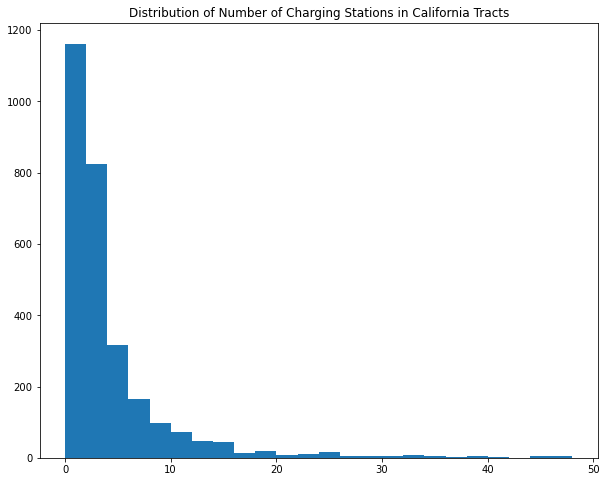

In [ ]:
# distribution of number of stations in California tracts
tract_stations = gdf_stations_proj_tracts.groupby('TractId')['id'].count().to_frame(name='total_stations')
plt.title('Distribution of Number of Charging Stations in California Tracts')
ax = plt.hist(tract_stations['total_stations'], bins=np.arange(0,50,2))
# plt.savefig('data/top 20 counties by charging stations in California tracts.png', dpi=DPI, bbox_inches='tight')

In [ ]:
tract_stations.head(5)

,index,TractId,total_stations,total_L1_charger,total_L2_charger,total_fast_charger
0,0,101050102,2,0.0,5.0,2.0
1,1,101050201,1,0.0,5.0,0.0
2,2,101050603,1,0.0,0.0,10.0
3,3,103000100,1,0.0,2.0,0.0
4,4,103000600,6,0.0,5.0,11.0


In [ ]:
tracts_proj.head(5)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,TractId
0,06,013,370000,1400000US06013370000,06013370000,3700,CT,999356,0,"POLYGON ((559142.408 4198819.055, 559216.664 4...",13370000
1,06,001,442301,1400000US06001442301,06001442301,4423.01,CT,1429049,0,"POLYGON ((590997.033 4154220.018, 591097.402 4...",1442301
2,06,037,405101,1400000US06037405101,06037405101,4051.01,CT,1121229,0,"POLYGON ((964258.816 3784627.076, 964662.228 3...",37405101
3,06,037,199800,1400000US06037199800,06037199800,1998,CT,651258,0,"POLYGON ((941638.181 3780666.251, 942123.200 3...",37199800
4,06,037,291300,1400000US06037291300,06037291300,2913,CT,2353751,45836,"POLYGON ((934074.348 3756766.632, 934056.015 3...",37291300


In [ ]:
tracts_proj.head(5)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,TractId
0,06,013,370000,1400000US06013370000,06013370000,3700,CT,999356,0,"POLYGON ((559142.408 4198819.055, 559216.664 4...",13370000
1,06,001,442301,1400000US06001442301,06001442301,4423.01,CT,1429049,0,"POLYGON ((590997.033 4154220.018, 591097.402 4...",1442301
2,06,037,405101,1400000US06037405101,06037405101,4051.01,CT,1121229,0,"POLYGON ((964258.816 3784627.076, 964662.228 3...",37405101
3,06,037,199800,1400000US06037199800,06037199800,1998,CT,651258,0,"POLYGON ((941638.181 3780666.251, 942123.200 3...",37199800
4,06,037,291300,1400000US06037291300,06037291300,2913,CT,2353751,45836,"POLYGON ((934074.348 3756766.632, 934056.015 3...",37291300


In [ ]:
tract_stations.head(5)

,index,TractId,total_stations,total_L1_charger,total_L2_charger,total_fast_charger
0,0,101050102,2,0.0,5.0,2.0
1,1,101050201,1,0.0,5.0,0.0
2,2,101050603,1,0.0,0.0,10.0
3,3,103000100,1,0.0,2.0,0.0
4,4,103000600,6,0.0,5.0,11.0


## Equity analysis 3: race/ ethnicity makeup

In [ ]:
census_df['total_charger']=census_df['total_L1_charger']+census_df['total_L2_charger']+census_df['total_fast_charger']

In [ ]:
census_df['charger_per_thousand_pop']=census_df['total_charger']/(census_df['TotalPop']/1000)
census_df

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,multi_house_pct,single_house_pct,TRACTCE,total_stations,total_L1_charger,total_L2_charger,total_fast_charger,Income Level,total_charger,charger_per_thousand_pop
0,0,1400100,California,Alameda County,2991,1442,1549,3.8,69.2,2.8,...,2.8,97.2,400100,0.0,0.0,0.0,0.0,Level9,0.0,0.0
1,1,1400200,California,Alameda County,1997,992,1005,8.9,71.3,0.9,...,29.6,70.5,400200,0.0,0.0,0.0,0.0,Level7,0.0,0.0
2,2,1400300,California,Alameda County,5123,2383,2740,7.5,67.0,9.4,...,54.1,45.7,400300,0.0,0.0,0.0,0.0,Level6,0.0,0.0
3,3,1400400,California,Alameda County,3991,1810,2181,9.4,65.8,6.0,...,55.4,44.7,400400,0.0,0.0,0.0,0.0,Level7,0.0,0.0
4,4,1400500,California,Alameda County,3944,1660,2284,10.3,53.4,24.1,...,46.9,53.1,400500,0.0,0.0,0.0,0.0,Level6,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8052,8052,115040800,California,Yuba County,4508,2380,2128,17.5,72.4,0.1,...,10.6,84.6,040800,0.0,0.0,0.0,0.0,Level5,0.0,0.0
8053,8053,115040901,California,Yuba County,3080,1562,1518,19.0,67.1,0.2,...,3.5,73.8,040901,0.0,0.0,0.0,0.0,Level5,0.0,0.0
8054,8054,115040902,California,Yuba County,1530,908,622,18.4,54.6,8.9,...,11.8,88.2,040902,0.0,0.0,0.0,0.0,Level4,0.0,0.0
8055,8055,115041000,California,Yuba County,7365,3971,3394,10.4,78.1,4.6,...,0.3,91.0,041000,0.0,0.0,0.0,0.0,Level6,0.0,0.0


In [ ]:
census_df2 = census_df[census_df['TotalPop']!=0]


8012

In [ ]:
census_df['other_race']= 100-census_df['Hispanic']-census_df['White']-census_df['Black']-census_df['Asian']-census_df['Pacific']

In [ ]:
census_df['Asian_p']=census_df['Asian']+census_df['Pacific']

In [ ]:
charger_value = census_df['total_charger'].unique()
charger_value_rank = pd.qcut(census_df['total_charger'].unique(), q = 10, labels = False)

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,multi_house_pct,single_house_pct,TRACTCE,total_stations,total_L1_charger,total_L2_charger,total_fast_charger,other_race,total_charger,total_charger_decileRank
0,0,1400100,California,Alameda County,2991,1442,1549,3.8,69.2,2.8,...,2.8,97.2,400100,0.0,0.0,0.0,0.0,0.0,0.0,0
1,1,1400200,California,Alameda County,1997,992,1005,8.9,71.3,0.9,...,29.6,70.5,400200,0.0,0.0,0.0,0.0,0.3,0.0,0
2,2,1400300,California,Alameda County,5123,2383,2740,7.5,67.0,9.4,...,54.1,45.7,400300,0.0,0.0,0.0,0.0,0.8,0.0,0
3,3,1400400,California,Alameda County,3991,1810,2181,9.4,65.8,6.0,...,55.4,44.7,400400,0.0,0.0,0.0,0.0,0.3,0.0,0
4,4,1400500,California,Alameda County,3944,1660,2284,10.3,53.4,24.1,...,46.9,53.1,400500,0.0,0.0,0.0,0.0,0.8,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8052,8052,115040800,California,Yuba County,4508,2380,2128,17.5,72.4,0.1,...,10.6,84.6,040800,0.0,0.0,0.0,0.0,1.6,0.0,0
8053,8053,115040901,California,Yuba County,3080,1562,1518,19.0,67.1,0.2,...,3.5,73.8,040901,0.0,0.0,0.0,0.0,1.7,0.0,0
8054,8054,115040902,California,Yuba County,1530,908,622,18.4,54.6,8.9,...,11.8,88.2,040902,0.0,0.0,0.0,0.0,0.3,0.0,0
8055,8055,115041000,California,Yuba County,7365,3971,3394,10.4,78.1,4.6,...,0.3,91.0,041000,0.0,0.0,0.0,0.0,1.3,0.0,0


In [ ]:
census_df['Hispanic_cnt']=census_df['TotalPop']*census_df['Hispanic']/100
census_df['White_cnt']=census_df['TotalPop']*census_df['White']/100
census_df['Asian_cnt']=census_df['TotalPop']*census_df['Asian_p']/100
census_df['Black_cnt']=census_df['TotalPop']*census_df['Black']/100
census_df['OtherRace_cnt']=census_df['TotalPop']*census_df['other_race']/100
census_df

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,total_fast_charger,other_race,total_charger,total_charger_decileRank,Hispanic_cnt,White_cnt,Asian_cnt,Black_cnt,OtherRace_cnt,Asian_p
0,0,1400100,California,Alameda County,2991,1442,1549,3.8,69.2,2.8,...,0.0,8.0,0.0,0,113.658,2069.772,484.542,83.748,239.280,16.2
1,1,1400200,California,Alameda County,1997,992,1005,8.9,71.3,0.9,...,0.0,9.1,0.0,0,177.733,1423.861,195.706,17.973,181.727,9.8
2,2,1400300,California,Alameda County,5123,2383,2740,7.5,67.0,9.4,...,0.0,5.5,0.0,0,384.225,3432.410,543.038,481.562,281.765,10.6
3,3,1400400,California,Alameda County,3991,1810,2181,9.4,65.8,6.0,...,0.0,6.7,0.0,0,375.154,2626.078,482.911,239.460,267.397,12.1
4,4,1400500,California,Alameda County,3944,1660,2284,10.3,53.4,24.1,...,0.0,5.8,0.0,0,406.232,2106.096,252.416,950.504,228.752,6.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8052,8052,115040800,California,Yuba County,4508,2380,2128,17.5,72.4,0.1,...,0.0,5.8,0.0,0,788.900,3263.792,189.336,4.508,261.464,4.2
8053,8053,115040901,California,Yuba County,3080,1562,1518,19.0,67.1,0.2,...,0.0,5.5,0.0,0,585.200,2066.680,252.560,6.160,169.400,8.2
8054,8054,115040902,California,Yuba County,1530,908,622,18.4,54.6,8.9,...,0.0,10.6,0.0,0,281.520,835.380,114.750,136.170,162.180,7.5
8055,8055,115041000,California,Yuba County,7365,3971,3394,10.4,78.1,4.6,...,0.0,4.2,0.0,0,765.960,5752.065,198.855,338.790,309.330,2.7


In [ ]:
tracts_with_station = census_df[census_df.total_charger>0]
tracts_with_station

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,Unemployment,multi_house_pct,single_house_pct,TRACTCE,total_stations,total_L1_charger,total_L2_charger,total_fast_charger,Income Level,total_charger
11,11,1401200,California,Alameda County,2601,1217,1384,18.7,51.2,16.5,...,8.6,50.9,49.2,401200,1.0,0.0,8.0,0.0,Level2,8.0
12,12,1401300,California,Alameda County,4054,2417,1637,13.5,34.5,32.5,...,13.0,90.8,9.3,401300,14.0,0.0,16.0,0.0,Level1,16.0
15,15,1401600,California,Alameda County,2098,1098,1000,12.9,25.3,45.1,...,6.2,64.1,35.9,401600,1.0,0.0,4.0,0.0,Level1,4.0
16,16,1401700,California,Alameda County,2769,1591,1178,29.0,32.9,26.0,...,6.0,60.5,39.4,401700,82.0,0.0,158.0,0.0,Level2,158.0
23,23,1402800,California,Alameda County,4255,2607,1648,8.5,28.4,41.2,...,9.1,98.4,1.3,402800,7.0,0.0,14.0,0.0,Level1,14.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8039,8039,113011206,California,Yolo County,8086,4044,4042,30.1,52.7,0.8,...,5.2,6.0,88.2,011206,5.0,0.0,11.0,8.0,Level2,19.0
8040,8040,113011300,California,Yolo County,8954,4452,4502,51.3,45.2,0.5,...,7.6,10.6,84.3,011300,1.0,0.0,1.0,0.0,Level2,1.0
8041,8041,113011400,California,Yolo County,4250,2065,2185,53.6,41.4,2.0,...,11.8,1.9,76.4,011400,3.0,0.0,2.0,5.0,Level1,7.0
8042,8042,113011500,California,Yolo County,5949,3049,2900,55.6,32.7,1.5,...,11.1,8.6,83.4,011500,3.0,0.0,13.0,0.0,Level2,13.0


In [ ]:
# check racial makeup of tracts without any chargers 
#census_df[census_df['White']>=50].total_charger.mean()  #3051    4.21
# census_df[census_df['Hispanic']+(census_df['Hispanic'])>=50] #4616
census_df[(census_df['Asian'])>=50].total_charger.mean() #360    5.6


#census_df[(census_df['Hispanic'])>=50].total_charger.mean() #2485   2.34
census_df[census_df['Hispanic']+(census_df['Black'])>=50].total_charger.mean() #554    2.69


census_df[census_df['Hispanic']+(census_df['Black'])>=50].total_stations.mean()  #1
census_df[(census_df['Asian'])>=50].total_stations.mean()  #2.11
census_df[(census_df['White'])>=50].total_stations.mean()  #1.67 

census_df[census_df['Hispanic']+(census_df['Black'])>=50]  #554
#census_df[(census_df['White']<50) &(census_df['Hispanic']<50)& (census_df['Asian']<50)]#2161

#census_df[(census_df['White'])>=50]

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,multi_house_pct,single_house_pct,TRACTCE,total_stations,total_L1_charger,total_L2_charger,total_fast_charger,Income Level,total_charger,charger_per_thousand_pop
6,6,1400700,California,Alameda County,4837,2464,2373,17.7,37.5,34.7,...,57.2,42.9,400700,0.0,0.0,0.0,0.0,Level5,0.0,0.000000
9,9,1401000,California,Alameda County,6247,3080,3167,19.8,29.3,36.6,...,55.9,44.1,401000,0.0,0.0,0.0,0.0,Level5,0.0,0.000000
13,13,1401400,California,Alameda County,4013,2038,1975,23.4,22.2,37.6,...,61.3,38.7,401400,0.0,0.0,0.0,0.0,Level3,0.0,0.000000
15,15,1401600,California,Alameda County,2098,1098,1000,12.9,25.3,45.1,...,64.1,35.9,401600,1.0,0.0,4.0,0.0,Level4,4.0,1.906578
16,16,1401700,California,Alameda County,2769,1591,1178,29.0,32.9,26.0,...,60.5,39.4,401700,82.0,0.0,158.0,0.0,Level6,158.0,57.060311
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8033,8033,113011101,California,Yolo County,3079,1543,1536,54.1,36.5,0.2,...,17.6,80.8,011101,1.0,0.0,2.0,0.0,Level5,2.0,0.649562
8034,8034,113011102,California,Yolo County,5048,2359,2689,66.0,17.9,2.2,...,31.4,48.6,011102,0.0,0.0,0.0,0.0,Level4,0.0,0.000000
8040,8040,113011300,California,Yolo County,8954,4452,4502,51.3,45.2,0.5,...,10.6,84.3,011300,1.0,0.0,1.0,0.0,Level6,1.0,0.111682
8041,8041,113011400,California,Yolo County,4250,2065,2185,53.6,41.4,2.0,...,1.9,76.4,011400,3.0,0.0,2.0,5.0,Level4,7.0,1.647059


In [ ]:
651/4616
176/554
773/2161
116/360

0.32222222222222224

In [ ]:
census_with_chargers

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,multi_house_pct,single_house_pct,TRACTCE,total_stations,total_L1_charger,total_L2_charger,total_fast_charger,Income Level,total_charger,charger_per_thousand_pop
11,11,1401200,California,Alameda County,2601,1217,1384,18.7,51.2,16.5,...,50.9,49.2,401200,1.0,0.0,8.0,0.0,Level6,8.0,3.075740
12,12,1401300,California,Alameda County,4054,2417,1637,13.5,34.5,32.5,...,90.8,9.3,401300,14.0,0.0,16.0,0.0,Level4,16.0,3.946719
15,15,1401600,California,Alameda County,2098,1098,1000,12.9,25.3,45.1,...,64.1,35.9,401600,1.0,0.0,4.0,0.0,Level4,4.0,1.906578
16,16,1401700,California,Alameda County,2769,1591,1178,29.0,32.9,26.0,...,60.5,39.4,401700,82.0,0.0,158.0,0.0,Level6,158.0,57.060311
23,23,1402800,California,Alameda County,4255,2607,1648,8.5,28.4,41.2,...,98.4,1.3,402800,7.0,0.0,14.0,0.0,Level4,14.0,3.290247
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8039,8039,113011206,California,Yolo County,8086,4044,4042,30.1,52.7,0.8,...,6.0,88.2,011206,5.0,0.0,11.0,8.0,Level6,19.0,2.349740
8040,8040,113011300,California,Yolo County,8954,4452,4502,51.3,45.2,0.5,...,10.6,84.3,011300,1.0,0.0,1.0,0.0,Level6,1.0,0.111682
8041,8041,113011400,California,Yolo County,4250,2065,2185,53.6,41.4,2.0,...,1.9,76.4,011400,3.0,0.0,2.0,5.0,Level4,7.0,1.647059
8042,8042,113011500,California,Yolo County,5949,3049,2900,55.6,32.7,1.5,...,8.6,83.4,011500,3.0,0.0,13.0,0.0,Level5,13.0,2.185241


In [ ]:
#census_with_chargers = census_df[census_df['total_stations']!=0]
#census_with_chargers[census_with_chargers['Asian']>=50]  #1183
#census_with_chargers[census_with_chargers['Hispanic']>=50]  #651
#census_with_chargers[census_with_chargers['Hispanic']+census_with_chargers['Black']>=50]  #116
#census_with_chargers[(census_with_chargers['White']<50) &(census_with_chargers['Hispanic']<50)& (census_with_chargers['Asian']<50)]#773

census_with_chargers[census_with_chargers['Hispanic']>=50] 

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,multi_house_pct,single_house_pct,TRACTCE,total_stations,total_L1_charger,total_L2_charger,total_fast_charger,Income Level,total_charger,charger_per_thousand_pop
62,62,1406100,California,Alameda County,4629,2506,2123,58.7,14.1,10.4,...,64.4,34.2,406100,1.0,0.0,105.0,0.0,Level4,105.0,22.683085
79,79,1407500,California,Alameda County,4362,2099,2263,51.6,6.2,31.7,...,60.8,38.4,407500,4.0,0.0,4.0,0.0,Level3,4.0,0.917011
94,94,1409000,California,Alameda County,3775,1882,1893,51.4,1.8,34.3,...,20.9,77.1,409000,21.0,8.0,28.0,17.0,Level4,53.0,14.039735
225,225,1436601,California,Alameda County,6915,3475,3440,52.4,11.5,10.6,...,34.2,64.5,436601,1.0,0.0,2.0,0.0,Level5,2.0,0.289226
229,229,1436900,California,Alameda County,6838,3433,3405,64.0,13.8,4.9,...,36.9,62.7,436900,1.0,0.0,2.0,0.0,Level5,2.0,0.292483
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8031,8031,113011001,California,Yolo County,7119,3296,3823,56.7,35.0,0.9,...,54.7,44.7,011001,1.0,0.0,2.0,0.0,Level4,2.0,0.280938
8033,8033,113011101,California,Yolo County,3079,1543,1536,54.1,36.5,0.2,...,17.6,80.8,011101,1.0,0.0,2.0,0.0,Level5,2.0,0.649562
8040,8040,113011300,California,Yolo County,8954,4452,4502,51.3,45.2,0.5,...,10.6,84.3,011300,1.0,0.0,1.0,0.0,Level6,1.0,0.111682
8041,8041,113011400,California,Yolo County,4250,2065,2185,53.6,41.4,2.0,...,1.9,76.4,011400,3.0,0.0,2.0,5.0,Level4,7.0,1.647059


## Equity Analysis 3: by EV registration at county level

In [ ]:

ev_pop_df= pd.read_csv('Vehicle Population_Last updated 08-28-2020.xlsx - County.csv')
ev_pop_df

,Data Year,County,Fuel Type,Make,Model,Number of Vehicles
0,2010,Alameda,BEV,Ford,Ranger,3
1,2010,Alameda,BEV,Tesla,Roadster,17
2,2010,Alameda,Bio Diesel,NaN,NaN,11
3,2010,Alameda,Diesel,NaN,NaN,10928
4,2010,Alameda,Flex Fuel,NaN,NaN,10974
...,...,...,...,...,...,...
15083,2019,Out Of State,PHEV,Volvo,XC90,11
15084,2019,Out Of State,PHEV,Volvo,XC60,3
15085,2019,Out Of State,PHEV,Volvo,S90,1
15086,2019,Out Of State,PHEV,Volvo,S60,2


In [ ]:
ev_pop_df2019= ev_pop_df[(ev_pop_df['Data Year']==2019) & (ev_pop_df['County'] != 'Out Of State')]
ev_pop_df2019

,Data Year,County,Fuel Type,Make,Model,Number of Vehicles
12122,2019,Alameda,BEV,Audi,e-tron,79
12123,2019,Alameda,BEV,BMW,i3,327
12124,2019,Alameda,BEV,Chevrolet,Spark EV,168
12125,2019,Alameda,BEV,Chevrolet,Bolt EV,3288
12126,2019,Alameda,BEV,FIAT,500e,574
...,...,...,...,...,...,...
15014,2019,Yuba,PHEV,Kia,Niro Plug-In Hybrid,4
15015,2019,Yuba,PHEV,Subaru,Crosstrek,2
15016,2019,Yuba,PHEV,Toyota,Prius Prime,23
15017,2019,Yuba,PHEV,Toyota,Prius Plug-in Hybrid,8


In [ ]:
ev_types = ['BEV','Gasoline Hybrid','PCEV','PHEV']
county_ev_2019 = ev_pop_df2019[ev_pop_df2019['Fuel Type'].isin(ev_types)].groupby(['County']).sum()['Number of Vehicles']

In [ ]:
gdf_stations_proj_tracts.groupby('COUNTYFP')['id'].count().to_frame(name='total_stations').reset_index().rename(columns={'index': 'COUNTYFP'})

,COUNTYFP,total_stations
0,001,803
1,003,4
2,005,12
3,007,22
4,009,4
5,011,4
6,013,317
7,015,11
8,017,60
9,019,293


In [ ]:
# number of EV/HY stations grouped by counties in California
county_stations = gdf_stations_proj_tracts.groupby('COUNTYFP')['id'].count().to_frame(name='total_stations').reset_index().rename(columns={'index': 'COUNTYFP'})

In [ ]:
# reference table of county name and county fips code
county_refer = pd.read_csv('https://raw.githubusercontent.com/kjhealy/fips-codes/master/state_and_county_fips_master.csv')
county_refer.to_csv('data/county_fips_reference.csv')
county_refer = county_refer[county_refer['state']=='CA']
county_refer.head()

,fips,name,state
192,6001,Alameda County,CA
193,6003,Alpine County,CA
194,6005,Amador County,CA
195,6007,Butte County,CA
196,6009,Calaveras County,CA


In [ ]:
county_refer['fips'] = county_refer['fips'].apply(lambda x: x%6000)

In [ ]:
county_refer = county_refer[['fips', 'name']].reset_index(drop=True)

In [ ]:
county_stations['COUNTYFP'] = county_stations['COUNTYFP'].astype(int)

In [ ]:
county_stations_name = pd.merge(county_stations, county_refer, how='left', left_on='COUNTYFP', right_on='fips')
county_stations_name.head()

,COUNTYFP,total_stations,fips,name
0,1,820,1,Alameda County
1,3,4,3,Alpine County
2,5,12,5,Amador County
3,7,22,7,Butte County
4,9,4,9,Calaveras County


In [ ]:
census_df.groupby(['County'])['total_charger'].sum()

County
Alameda County            1992.0
Alpine County               14.0
Amador County               33.0
Butte County                58.0
Calaveras County            19.0
Colusa County               26.0
Contra Costa County        791.0
Del Norte County            27.0
El Dorado County           157.0
Fresno County              760.0
Glenn County                14.0
Humboldt County            108.0
Imperial County             20.0
Inyo County                 32.0
Kern County                230.0
Kings County                87.0
Lake County                 12.0
Lassen County                4.0
Los Angeles County        7790.0
Madera County              102.0
Marin County               539.0
Mariposa County             17.0
Mendocino County           132.0
Merced County               96.0
Modoc County                 4.0
Mono County                 32.0
Monterey County            360.0
Napa County                359.0
Nevada County               56.0
Orange County             3008.0
Pla

In [ ]:
county_stations_name['total_chargers']=list(census_df.groupby(['County'])['total_charger'].sum())
county_stations_name

,COUNTYFP,total_stations,fips,name,total_chargers
0,1,820,1,Alameda County,1992.0
1,3,4,3,Alpine County,14.0
2,5,12,5,Amador County,33.0
3,7,22,7,Butte County,58.0
4,9,4,9,Calaveras County,19.0
5,11,4,11,Colusa County,26.0
6,13,317,13,Contra Costa County,791.0
7,15,11,15,Del Norte County,27.0
8,17,61,17,El Dorado County,157.0
9,19,315,19,Fresno County,760.0


In [ ]:
census_df.merge(county_stations_name[['name','total_stations']].rename(columns={"name": "County"}),how="left")

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,multi_house_pct,single_house_pct,TRACTCE,total_stations,total_L1_charger,total_L2_charger,total_fast_charger,Income Level,total_charger,charger_per_thousand_pop
0,0,1400100,California,Alameda County,2991,1442,1549,3.8,69.2,2.8,...,2.8,97.2,400100,0.0,0.0,0.0,0.0,Level9,0.0,0.0
1,1,1400200,California,Alameda County,1997,992,1005,8.9,71.3,0.9,...,29.6,70.5,400200,0.0,0.0,0.0,0.0,Level7,0.0,0.0
2,2,1400300,California,Alameda County,5123,2383,2740,7.5,67.0,9.4,...,54.1,45.7,400300,0.0,0.0,0.0,0.0,Level6,0.0,0.0
3,3,1400400,California,Alameda County,3991,1810,2181,9.4,65.8,6.0,...,55.4,44.7,400400,0.0,0.0,0.0,0.0,Level7,0.0,0.0
4,4,1400500,California,Alameda County,3944,1660,2284,10.3,53.4,24.1,...,46.9,53.1,400500,0.0,0.0,0.0,0.0,Level6,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8052,8052,115040800,California,Yuba County,4508,2380,2128,17.5,72.4,0.1,...,10.6,84.6,040800,0.0,0.0,0.0,0.0,Level5,0.0,0.0
8053,8053,115040901,California,Yuba County,3080,1562,1518,19.0,67.1,0.2,...,3.5,73.8,040901,0.0,0.0,0.0,0.0,Level5,0.0,0.0
8054,8054,115040902,California,Yuba County,1530,908,622,18.4,54.6,8.9,...,11.8,88.2,040902,0.0,0.0,0.0,0.0,Level4,0.0,0.0
8055,8055,115041000,California,Yuba County,7365,3971,3394,10.4,78.1,4.6,...,0.3,91.0,041000,0.0,0.0,0.0,0.0,Level6,0.0,0.0


In [ ]:
# reference table of county population and county name: https://www.california-demographics.com/counties_by_population
df_countypop = pd.read_csv('data/countiespop.csv')
df_countypop.head()

,Rank,County,Population
0,1,Los Angeles County,10039107
1,2,San Diego County,3338330
2,3,Orange County,3175692
3,4,Riverside County,2470546
4,5,San Bernardino County,2180085


In [ ]:
county_stat_name_pop = pd.merge(county_stations_name, df_countypop, how='left', left_on='name', right_on='County')
county_stat_name_pop.head()

,COUNTYFP,total_stations,fips,name,total_chargers,Rank,County,Population
0,1,820,1,Alameda County,1992.0,7,Alameda County,1671329
1,3,4,3,Alpine County,14.0,58,Alpine County,1129
2,5,12,5,Amador County,33.0,46,Amador County,39752
3,7,22,7,Butte County,58.0,28,Butte County,219186
4,9,4,9,Calaveras County,19.0,44,Calaveras County,45905


In [ ]:
# reference table of county household median income: https://www.indexmundi.com/facts/united-states/quick-facts/california/median-household-income#table
df_countymedinc = pd.read_csv('data/county_medinc.csv')
df_countymedinc.head()

,County,med_income
0,Alameda County,92574
1,Alpine County,64688
2,Amador County,61198
3,Butte County,48443
4,Calaveras County,58151


In [ ]:
county_full = pd.merge(county_stat_name_pop, df_countymedinc, how='left', left_on='name', right_on='County')
county_full.head()

,COUNTYFP,total_stations,fips,name,total_chargers,Rank,County_x,Population,County_y,med_income
0,1,820,1,Alameda County,1992.0,7,Alameda County,1671329,Alameda County,92574
1,3,4,3,Alpine County,14.0,58,Alpine County,1129,Alpine County,64688
2,5,12,5,Amador County,33.0,46,Amador County,39752,Amador County,61198
3,7,22,7,Butte County,58.0,28,Butte County,219186,Butte County,48443
4,9,4,9,Calaveras County,19.0,44,Calaveras County,45905,Calaveras County,58151


In [ ]:
county_full.drop(['County_x', 'County_y', 'COUNTYFP', 'Rank'], axis=1, inplace=True)
county_full.head()

,total_stations,fips,name,total_chargers,Population,med_income
0,820,1,Alameda County,1992.0,1671329,92574
1,4,3,Alpine County,14.0,1129,64688
2,12,5,Amador County,33.0,39752,61198
3,22,7,Butte County,58.0,219186,48443
4,4,9,Calaveras County,19.0,45905,58151


In [ ]:
county_ev_2019=county_ev_2019.to_frame().reset_index().rename(columns={'County': 'name'})


NameError: name 'county_ev_2019' is not defined

In [ ]:
county_full['name']= county_full['name'].apply(lambda x: str(x)[:-7])
county_full = county_full.merge(county_ev_2019)

In [ ]:
county_full['EV per million population']= county_full['Number of Vehicles']/(county_full['Population']/1000000)
county_full['EV per chargepoint']= county_full['Number of Vehicles']/county_full['total_stations']
county_full

,total_stations,fips,name,Population,med_income,Number of Vehicles,EV per million population,EV per chargepoint
0,803,1,Alameda,1671329,92574,109346,65424.581276,136.171856
1,4,3,Alpine,1129,64688,36,31886.625332,9.000000
2,12,5,Amador,39752,61198,981,24678.003622,81.750000
3,22,7,Butte,219186,48443,4938,22528.811147,224.454545
4,4,9,Calaveras,45905,58151,1259,27426.206296,314.750000
5,4,11,Colusa,21547,56704,279,12948.438298,69.750000
6,317,13,Contra Costa,1153526,93712,65987,57204.605705,208.160883
7,11,15,Del Norte,27812,45258,413,14849.705163,37.545455
8,60,17,El Dorado,192843,80582,7303,37870.184554,121.716667
9,293,19,Fresno,999101,51261,18825,18841.938903,64.249147


In [ ]:
# used urban/suburban/rural code organized by the California State Association of Counties that assigned each county in California an urbanization level.

urban_counties = ["Alameda", "Contra Costa","Fresno","Los Angeles","Orange",
                 "Riverside","Sacramento","San Bernardino", "San Diego",
                 "San Francisco", "San Joaquin","San Mateo","Santa Clara",
                 "Ventura"]

suburban_counties = ["Butte","Imperial","Kern","Marin","Merced","Monterey","Napa",
                     "Placer", "San Luis Obispo", "Santa Barbara", "Santa Cruz", "Shasta",
                     "Solano","Sonoma","Stanislaus", "Tulare", "Yolo"]

rural_counties = ["Alpine","Amador","Calaveras","Colusa","Del Norte", "El Dorado",
                 "Glenn","Humboldt","Inyo","Kings", "Lake","Lassen","Madera","Mariposa",
                 "Mendocino", "Modoc", "Mono", "Nevada", "Plumas", "San Benito",
                 "Sierra","Siskiyo", "Sutter", "Tehama", "Trinity", "Tuolumne", 
                 "Yuba "]

def get_urbanized_level(x):
    if x in urban_counties:
        return "urban"
    elif x in suburban_counties:
        return "suburban"
    else:
        return "rural_counties"
county_full['urban_level']=county_full['name'].apply(get_urbanized_level)
county_full

,total_stations,fips,name,Population,med_income,Number of Vehicles,EV per million population,EV per chargepoint,urban_level
0,803,1,Alameda,1671329,92574,109346,65424.581276,136.171856,urban
1,4,3,Alpine,1129,64688,36,31886.625332,9.000000,rural_counties
2,12,5,Amador,39752,61198,981,24678.003622,81.750000,rural_counties
3,22,7,Butte,219186,48443,4938,22528.811147,224.454545,suburban
4,4,9,Calaveras,45905,58151,1259,27426.206296,314.750000,rural_counties
5,4,11,Colusa,21547,56704,279,12948.438298,69.750000,rural_counties
6,317,13,Contra Costa,1153526,93712,65987,57204.605705,208.160883,urban
7,11,15,Del Norte,27812,45258,413,14849.705163,37.545455,rural_counties
8,60,17,El Dorado,192843,80582,7303,37870.184554,121.716667,rural_counties
9,293,19,Fresno,999101,51261,18825,18841.938903,64.249147,urban


In [ ]:
# save a copy to csv file
county_full.to_csv('data/county_stat2.csv')

In [ ]:
census_df['total_charger ']= census_df['total_L1_charger']+census_df['total_L2_charger']+census_df['total_fast_charger']
census_df['total_charger ']

32817.0

In [ ]:
county_full2['station per thousand population'] = (county_full2['Population']/1000)/county_full2['total_stations']
county_full2['total_charger']= list(census_df.groupby(['County'])['total_charger '].sum())
county_full2['num of charger per million population']=county_full2['total_charger']/(county_full2['Population']/1000000)
county_full2

,Unnamed: 0,total_stations,fips,name,Population,med_income,Number of Vehicles,EV per million population,EV per chargepoint,urban_level,station per thousand population,total_charger,num of charger per million population
0,0,803,1,Alameda,1671329,92574,109346,65424.581276,136.171856,urban,2.081356,1988.0,1189.472569
1,1,4,3,Alpine,1129,64688,36,31886.625332,9.000000,rural_counties,0.282250,14.0,12400.354296
2,2,12,5,Amador,39752,61198,981,24678.003622,81.750000,rural_counties,3.312667,33.0,830.146911
3,3,22,7,Butte,219186,48443,4938,22528.811147,224.454545,suburban,9.963000,58.0,264.615441
4,4,4,9,Calaveras,45905,58151,1259,27426.206296,314.750000,rural_counties,11.476250,19.0,413.898268
5,5,4,11,Colusa,21547,56704,279,12948.438298,69.750000,rural_counties,5.386750,26.0,1206.664501
6,6,317,13,Contra Costa,1153526,93712,65987,57204.605705,208.160883,urban,3.638883,791.0,685.723599
7,7,11,15,Del Norte,27812,45258,413,14849.705163,37.545455,rural_counties,2.528364,27.0,970.803970
8,8,60,17,El Dorado,192843,80582,7303,37870.184554,121.716667,rural_counties,3.214050,155.0,803.762646
9,9,293,19,Fresno,999101,51261,18825,18841.938903,64.249147,urban,3.409901,760.0,760.683855


In [ ]:
county_full2.to_csv('data/county_stat2.csv')

In [ ]:
county_full['stations_per_1000pop'] = round(1000*county_full['total_stations']/county_full['Population'], 2)

<AxesSubplot:title={'center':'Top 20 Counties in California with most EV/HY charging stations'}, ylabel='name'>

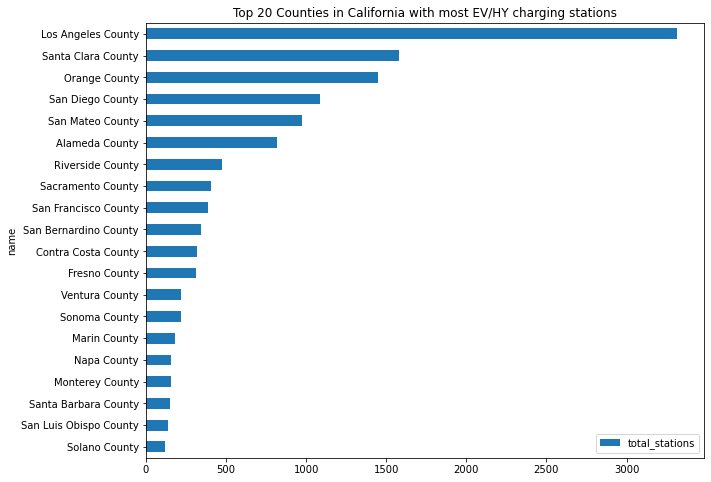

In [ ]:
county_stat = county_full[['name', 'total_stations']].set_index('name')
county_stat.sort_values('total_stations')[-20:].plot(kind='barh', title='Top 20 Counties in California with most EV/HY charging stations')
# plt.savefig('data/top 20 counties by total stations.png', dpi=DPI, bbox_inches='tight')

In [ ]:
stat = county_stat.sort_values(by='total_stations', ascending=False)
stat

,total_stations
name,
Los Angeles County,3317
Santa Clara County,1580
Orange County,1451
San Diego County,1085
San Mateo County,971
Alameda County,820
Riverside County,477
Sacramento County,404
San Francisco County,385


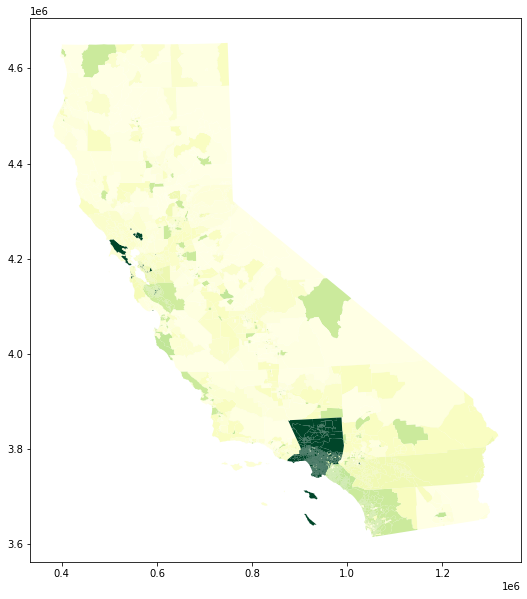

In [ ]:
# Choropleth Maps of total stations in counties
county_stat2 = county_full[['fips','total_stations']]

counties_proj['COUNTYFP'] = counties_proj['COUNTYFP'].apply(lambda x: int(x))
counties_proj = counties_proj.set_index('COUNTYFP')

stat2 = pd.merge(counties_proj, county_stat2, how='left', left_index=True, right_on='fips')
ax = stat2.plot(column='total_stations', colormap = 'YlGn', figsize=(16, 10))

<AxesSubplot:title={'center':'Top 20 Counties with most EV/HY charging stations per 1000 population'}, ylabel='name'>

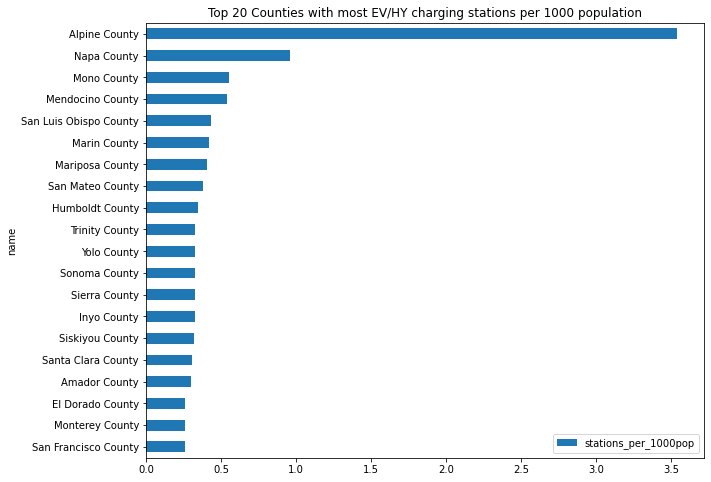

In [ ]:
county_stat_perpop = county_full[['name', 'stations_per_1000pop']].set_index('name')
county_stat_perpop.sort_values('stations_per_1000pop')[-20:].plot(kind='barh', title='Top 20 Counties with most EV/HY charging stations per 1000 population')
# plt.savefig('data/top 20 counties by stations per 1000 population.png', dpi=DPI, bbox_inches='tight')

In [ ]:
stat_inc = county_full[['name', 'total_stations', 'Population', 'med_income']].set_index('name')
stat_inc.head()

,total_stations,Population,med_income
name,,,
Alameda County,368,1671329,92574
Alpine County,4,1129,64688
Amador County,12,39752,61198
Butte County,18,219186,48443
Calaveras County,3,45905,58151


## Equity Analysis 4: Advantaged & Disadvantaged Communities (based on CalEnviroScreen Score)

In [ ]:
ces3_df = pd.read_csv("ces3results.csv")
ces3_df.columns

Index(['Census Tract', 'Total Population', 'California County', 'ZIP',
       'Nearby City \n(to help approximate location only)', 'Longitude',
       'Latitude', 'CES 3.0 Score', ' CES 3.0 Percentile',
       'CES 3.0 \nPercentile Range', 'SB 535 Disadvantaged Community', 'Ozone',
       'Ozone Pctl', 'PM2.5', 'PM2.5 Pctl', 'Diesel PM', 'Diesel PM Pctl',
       'Drinking Water', 'Drinking Water Pctl', 'Pesticides',
       'Pesticides Pctl', 'Tox. Release', 'Tox. Release Pctl', 'Traffic',
       'Traffic Pctl', 'Cleanup Sites', 'Cleanup Sites Pctl',
       'Groundwater Threats', 'Groundwater Threats Pctl', 'Haz. Waste',
       'Haz. Waste Pctl', 'Imp. Water Bodies', 'Imp. Water Bodies Pctl',
       'Solid Waste', 'Solid Waste Pctl', 'Pollution Burden',
       'Pollution Burden Score', 'Pollution Burden Pctl', 'Asthma',
       'Asthma Pctl', 'Low Birth Weight', 'Low Birth Weight Pctl',
       'Cardiovascular Disease', 'Cardiovascular Disease Pctl', 'Education',
       'Education Pctl', 

In [ ]:
def get_tractid(num):
    return int(str(num)[1:])
ces3_df['TractId']=ces3_df['Census Tract'].apply(get_tractid)
ces3_df

,Census Tract,Total Population,California County,ZIP,Nearby City \n(to help approximate location only),Longitude,Latitude,CES 3.0 Score,CES 3.0 Percentile,CES 3.0 \nPercentile Range,...,Poverty,Poverty Pctl,Unemployment,Unemployment Pctl,Housing Burden,Housing Burden Pctl,Pop. Char.,Pop. Char. Score,Pop. Char. Pctl,TractId
0,6019001100,3174,Fresno,93706,Fresno,-119.781696,36.709695,94.09,100.00,95-100% (highest scores),...,76.3,97.12,17.6,91.72,26.0,79.40,92.12,9.55,99.70,19001100
1,6071001600,6133,San Bernardino,91761,Ontario,-117.618013,34.057780,90.68,99.99,95-100% (highest scores),...,72.5,94.63,12.3,71.82,34.1,93.75,87.44,9.07,98.11,71001600
2,6019000200,3167,Fresno,93706,Fresno,-119.805504,36.735491,85.97,99.97,95-100% (highest scores),...,86.8,99.56,16.1,87.98,40.1,97.85,94.58,9.81,99.99,19000200
3,6077000801,6692,San Joaquin,95203,Stockton,-121.314524,37.940517,82.49,99.96,95-100% (highest scores),...,61.3,85.57,19.6,94.97,21.1,63.54,86.70,8.99,97.72,77000801
4,6019001500,2206,Fresno,93725,Fresno,-119.717843,36.681600,82.03,99.95,95-100% (highest scores),...,66.4,90.23,18.6,93.65,28.1,83.98,80.08,8.30,92.76,19001500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8030,6009000504,942,Calaveras,95223,Arnold,-120.211151,38.405130,NaN,NaN,NaN,...,24.7,35.76,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9000504
8031,6065940100,166,Riverside,92239,Desert Center,-114.475335,34.000183,NaN,NaN,NaN,...,21.0,28.81,NaN,NaN,NaN,NaN,NaN,NaN,NaN,65940100
8032,6053011502,1710,Monterey,93923,Carmel,-121.735102,36.301079,NaN,NaN,NaN,...,29.0,43.07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,53011502
8033,6083980100,11,Santa Barbara,57,Channel Islands,-120.048221,33.948186,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83980100


In [ ]:
census_df= pd.merge(census_df,ces3_df[['TractId',' CES 3.0 Percentile']],how="left",on="TractId")
census_df

,Unnamed: 0,TractId,State,County,TotalPop,Men,Women,Hispanic,White,Black,...,single_house_pct,TRACTCE,total_stations,total_L1_charger,total_L2_charger,total_fast_charger,Income Level,total_charger,charger_per_thousand_pop,CES 3.0 Percentile
0,0,1400100,California,Alameda County,2991,1442,1549,3.8,69.2,2.8,...,97.2,400100,0.0,0.0,0.0,0.0,Level9,0.0,0.0,1.87
1,1,1400200,California,Alameda County,1997,992,1005,8.9,71.3,0.9,...,70.5,400200,0.0,0.0,0.0,0.0,Level7,0.0,0.0,0.25
2,2,1400300,California,Alameda County,5123,2383,2740,7.5,67.0,9.4,...,45.7,400300,0.0,0.0,0.0,0.0,Level6,0.0,0.0,17.63
3,3,1400400,California,Alameda County,3991,1810,2181,9.4,65.8,6.0,...,44.7,400400,0.0,0.0,0.0,0.0,Level7,0.0,0.0,15.02
4,4,1400500,California,Alameda County,3944,1660,2284,10.3,53.4,24.1,...,53.1,400500,0.0,0.0,0.0,0.0,Level6,0.0,0.0,34.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8052,8052,115040800,California,Yuba County,4508,2380,2128,17.5,72.4,0.1,...,84.6,040800,0.0,0.0,0.0,0.0,Level5,0.0,0.0,51.24
8053,8053,115040901,California,Yuba County,3080,1562,1518,19.0,67.1,0.2,...,73.8,040901,0.0,0.0,0.0,0.0,Level5,0.0,0.0,66.67
8054,8054,115040902,California,Yuba County,1530,908,622,18.4,54.6,8.9,...,88.2,040902,0.0,0.0,0.0,0.0,Level4,0.0,0.0,26.52
8055,8055,115041000,California,Yuba County,7365,3971,3394,10.4,78.1,4.6,...,91.0,041000,0.0,0.0,0.0,0.0,Level6,0.0,0.0,33.47


### Level2 charger quantity across quantiles (Q4 for disadvantaged communities)

In [ ]:
#q4
total_l2 = census_df[(census_df[' CES 3.0 Percentile']>75)].total_L2_charger.sum()
total_pop = census_df[(census_df[' CES 3.0 Percentile']>75)].TotalPop.sum()
total_l2/total_pop*100000

61.86127174460499

In [ ]:
#q3
total_l2 = census_df[(census_df[' CES 3.0 Percentile']>50)&(census_df[' CES 3.0 Percentile']<=75)].total_L2_charger.sum()
total_pop = census_df[(census_df[' CES 3.0 Percentile']>50)&(census_df[' CES 3.0 Percentile']<=75)].TotalPop.sum()
total_l2/total_pop*100000

65.83748579264996

In [ ]:
#q2
total_l2 = census_df[(census_df[' CES 3.0 Percentile']>25)&(census_df[' CES 3.0 Percentile']<=50)].total_L2_charger.sum()
total_pop = census_df[(census_df[' CES 3.0 Percentile']>25)&(census_df[' CES 3.0 Percentile']<=50)].TotalPop.sum()
total_l2/total_pop*100000

68.28519560585373

In [ ]:
#q1
total_l2 = census_df[(census_df[' CES 3.0 Percentile']<25)].total_L2_charger.sum()
total_pop = census_df[(census_df[' CES 3.0 Percentile']<25)].TotalPop.sum()
total_l2/total_pop*100000

71.08484420300164

### dcfc charger quantity across quantiles (Q4 for disadvantaged communities)

In [ ]:
total_fast = census_df[(census_df[' CES 3.0 Percentile']>75)].total_fast_charger.sum()
total_pop = census_df[(census_df[' CES 3.0 Percentile']>75)].TotalPop.sum()
total_fast/total_pop*100000

12.842847803546512

In [ ]:
total_fast = census_df[(census_df[' CES 3.0 Percentile']>50)&(census_df[' CES 3.0 Percentile']<=75)].total_fast_charger.sum()
total_pop = census_df[(census_df[' CES 3.0 Percentile']>50)&(census_df[' CES 3.0 Percentile']<=75)].TotalPop.sum()
total_fast/total_pop*100000

13.854773371661894

In [ ]:
#q2
total_fast = census_df[(census_df[' CES 3.0 Percentile']>25)&(census_df[' CES 3.0 Percentile']<=50)].total_fast_charger.sum()
total_pop = census_df[(census_df[' CES 3.0 Percentile']>25)&(census_df[' CES 3.0 Percentile']<=50)].TotalPop.sum()
total_fast/total_pop*100000

15.12058209389538

In [ ]:
#q1
total_fast = census_df[(census_df[' CES 3.0 Percentile']<25)].total_fast_charger.sum()
total_pop = census_df[(census_df[' CES 3.0 Percentile']<25)].TotalPop.sum()
total_fast/total_pop*100000

14.171359866317925